In [ ]:
import os
import pandas as pd

def build_general_df(root_dir):
    """
    General recursive builder for any 'labels'-'images' directory pairs under root_dir,
    replacing folder name and extension as before.
    """
    pairs = []
    for dirpath, dirnames, filenames in os.walk(root_dir):
        if os.path.basename(dirpath).lower() == 'labels':
            for fname in filenames:
                label_path = os.path.join(dirpath, fname)
                image_path = label_path.replace(os.sep + 'labels' + os.sep,
                                                os.sep + 'images' + os.sep)
                stem = os.path.splitext(image_path)[0]
                image_path = stem + '.JPG'
                pairs.append({
                    'image_path': os.path.normpath(image_path),
                    'label_path': os.path.normpath(label_path)
                })
    return pd.DataFrame(pairs, columns=['image_path', 'label_path'])


def build_train_s1_df(s1_dir):
    """
    Handles the special 01_train-s1__DataSet_Human_Rescue folder structure:
    each numbered subfolder under 'labels' and 'images'.
    """
    pairs = []
    images_root = os.path.join(s1_dir, 'images')
    labels_root = os.path.join(s1_dir, 'labels')
    if not os.path.isdir(images_root) or not os.path.isdir(labels_root):
        return pd.DataFrame(columns=['image_path', 'label_path'])
    for subname in os.listdir(labels_root):
        lab_subdir = os.path.join(labels_root, subname)
        img_subdir = os.path.join(images_root, subname)
        if not os.path.isdir(lab_subdir) or not os.path.isdir(img_subdir):
            continue
        for fname in os.listdir(lab_subdir):
            label_path = os.path.join(lab_subdir, fname)
            stem = os.path.splitext(fname)[0]
            image_path = os.path.join(img_subdir, stem + '.JPG')
            pairs.append({
                'image_path': os.path.normpath(image_path),
                'label_path': os.path.normpath(label_path)
            })
    return pd.DataFrame(pairs, columns=['image_path', 'label_path'])


if __name__ == '__main__':
    root_dir =r"E:\DroneFootageDataset\dataset".strip()
    df_general = build_general_df(root_dir)
    s1_folder = os.path.join(root_dir, '01_train-s1__DataSet_Human_Rescue')
    df_s1 = build_train_s1_df(s1_folder)
    df_all = pd.concat([df_general, df_s1], ignore_index=True)
    print(df_all)


                                              image_path  \
0      E:\DroneFootageDataset\dataset\02_part_dataset...   
1      E:\DroneFootageDataset\dataset\02_part_dataset...   
2      E:\DroneFootageDataset\dataset\02_part_dataset...   
3      E:\DroneFootageDataset\dataset\02_part_dataset...   
4      E:\DroneFootageDataset\dataset\02_part_dataset...   
...                                                  ...   
60017  E:\DroneFootageDataset\dataset\01_train-s1__Da...   
60018  E:\DroneFootageDataset\dataset\01_train-s1__Da...   
60019  E:\DroneFootageDataset\dataset\01_train-s1__Da...   
60020  E:\DroneFootageDataset\dataset\01_train-s1__Da...   
60021  E:\DroneFootageDataset\dataset\01_train-s1__Da...   

                                              label_path  
0      E:\DroneFootageDataset\dataset\02_part_dataset...  
1      E:\DroneFootageDataset\dataset\02_part_dataset...  
2      E:\DroneFootageDataset\dataset\02_part_dataset...  
3      E:\DroneFootageDataset\dataset\02_pa

In [14]:
df_all['image_dir'] = df_all['image_path'].apply(os.path.dirname)
df_all['image_dir'].unique()

array(['E:\\DroneFootageDataset\\dataset\\02_part_dataset_human_rescue\\02_second_part_DataSet_Human_Rescue\\images',
       'E:\\DroneFootageDataset\\dataset\\03_part_dataset_human_rescue\\03_part_dataset_human_rescue\\03_validation__DataSet_Human_Rescue\\private\\images',
       'E:\\DroneFootageDataset\\dataset\\03_part_dataset_human_rescue\\03_part_dataset_human_rescue\\03_validation__DataSet_Human_Rescue\\public\\images',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\01',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\02',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\03',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\04',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\05',
       'E:\\DroneFootageDataset\\dataset\\01_train-s1__DataSet_Human_Rescue\\images\\06',
       'E:\\DroneFootageDatas

In [ ]:
def count_label_lines(path):
    """Counts the number of lines in a text file at the given path."""
    with open(path, 'r', encoding='utf-8') as f:
        return sum(1 for _ in f)

df_all['targets'] = df_all['label_path'].apply(count_label_lines)


In [ ]:
print(df_all['targets'].unique())
print(df_all[df_all['targets'] == 19])
df_all

[ 1  4  2  3  7  5  6  9  8 11 10 13 12 15 17 14 16 18 23 21 19  0]


In [ ]:
from PIL import Image
from tqdm import tqdm

heights = []
widths = []

for img_path in tqdm(df_all['image_path'], desc='Processing images'):
    try:
        with Image.open(img_path) as img:
            widths.append(img.width)
            heights.append(img.height)
    except Exception as e:
        widths.append(None)
        heights.append(None)

df_all['height'] = heights
df_all['width'] = widths


Processing images: 100%|██████████| 60022/60022 [05:42<00:00, 175.33it/s]


In [22]:
df_all.to_pickle('targets_flattened.pkl')

In [24]:
import pandas as pd
from tqdm import tqdm

records = []
for _, row in tqdm(df_all.iterrows(), total=len(df_all), desc="Expanding targets"):
    img_path   = row['image_path']
    lbl_path   = row['label_path']
    targets    = row['targets']
    height     = row['height']
    width      = row['width']

    with open(lbl_path, 'r', encoding='utf-8') as f:
        lines = [ln.strip() for ln in f if ln.strip()]

    for ln in lines:
        parts = ln.split()
        xc, yc, w_norm, h_norm = map(float, parts[1:5])
        records.append({
            'image_path': img_path,
            'label_path': lbl_path,
            'targets':    targets,
            'height':     height,
            'width':      width,
            'xc':         xc,
            'yc':         yc,
            'w':          w_norm,
            'h':          h_norm
        })

df_final = pd.DataFrame(records, columns=[
    'image_path','label_path','targets','height','width','xc','yc','w','h'
])



Expanding targets: 100%|██████████| 60022/60022 [02:52<00:00, 348.60it/s] 


In [ ]:
df_final.to_pickle("final.pkl")
df_final

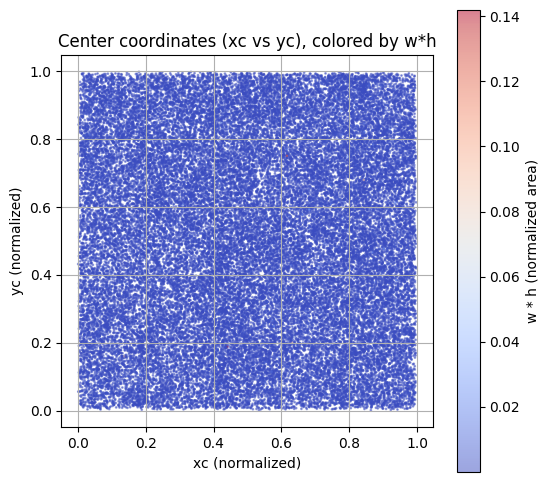

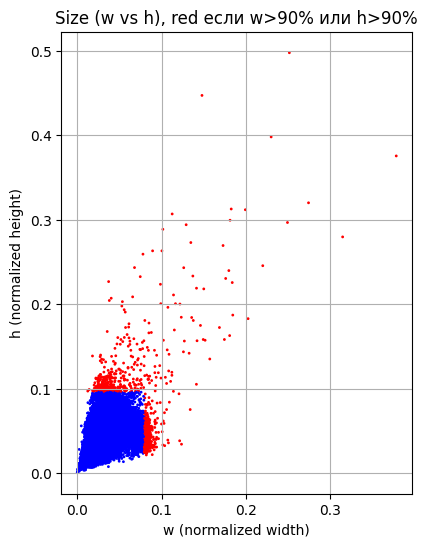

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

colors = df_final['w'] * df_final['h']

fig, ax = plt.subplots(figsize=(6, 6))
sc = ax.scatter(
    df_final['xc'],
    df_final['yc'],
    c=colors,
    cmap='coolwarm',
    s=1,
    alpha=0.5
)
ax.set_title('Center coordinates (xc vs yc), colored by w*h')
ax.set_xlabel('xc (normalized)')
ax.set_ylabel('yc (normalized)')
ax.set_aspect('equal', 'box')  
ax.grid(True)

cbar = fig.colorbar(sc, ax=ax)
cbar.set_label('w * h (normalized area)')

plt.show()


w = df_final['w'].values
h = df_final['h'].values

p90_w = np.percentile(w, 99)
p90_h = np.percentile(h, 99)

colors = [
    'red' if (wi > p90_w or hi > p90_h) else 'blue'
    for wi, hi in zip(w, h)
]

fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(w, h, c=colors, s=1, alpha=1)
ax.set_title('Size (w vs h), red если w>90% или h>90%')
ax.set_xlabel('w (normalized width)')
ax.set_ylabel('h (normalized height)')
ax.set_aspect('equal', 'box')
ax.grid(True)
plt.show()



In [ ]:
value1 = 0.1  
value2 = 0.1  

count = ((df_final['h'] > p90_h) | (df_final['w'] > p90_w)).sum()
print(f'Число записей с h>{value1} и w>{value2}:', count)

Число записей с h>0.1 и w>0.1: 916


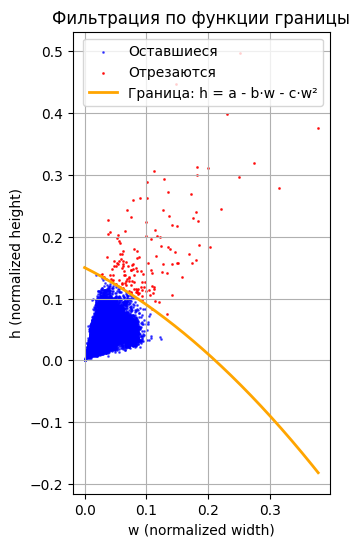

In [81]:
import numpy as np
import matplotlib.pyplot as plt

a, b, c = 0.15, 0.5, 1

def boundary(w):
    return a - b * w - c * w**2

w_vals = np.linspace(0, df_final['w'].max(), 300)
h_vals = boundary(w_vals)

mask_removed = df_final['h'] > boundary(df_final['w'])

fig, ax = plt.subplots(figsize=(6, 6))

ax.scatter(df_final['w'][~mask_removed],
           df_final['h'][~mask_removed],
           c='blue', s=1, alpha=0.6, label='Оставшиеся')

ax.scatter(df_final['w'][mask_removed],
           df_final['h'][mask_removed],
           c='red', s=1, alpha=0.8, label='Отрезаются')

ax.plot(w_vals, h_vals,
        color='orange', lw=2, label='Граница: h = a - b·w - c·w²')

ax.set_title('Фильтрация по функции границы')
ax.set_xlabel('w (normalized width)')
ax.set_ylabel('h (normalized height)')
ax.set_aspect('equal', 'box')
ax.grid(True)
ax.legend()

plt.show()


In [ ]:
a, b, c = 0.15, 0.5, 0.8

def boundary(w): 
    return a - b*w - c*w**2

df_left = df_final[df_final['h'] <= boundary(df_final['w'])]

In [80]:
df_left.to_pickle("cropped.pkl")

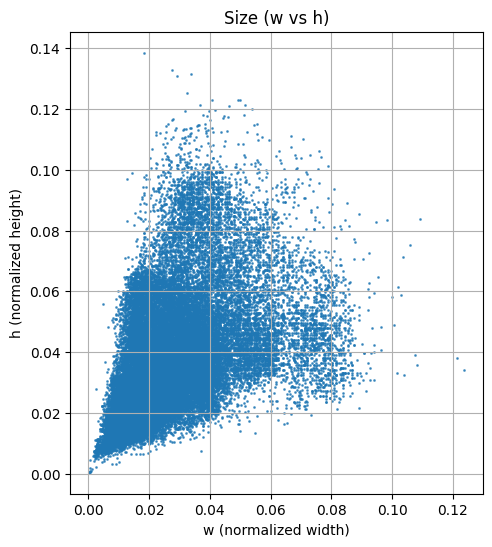

In [82]:
fig, ax = plt.subplots(figsize=(6, 6))
ax.scatter(df_left['w'], df_left['h'], s=1, alpha=0.7)
ax.set_title('Size (w vs h)')
ax.set_xlabel('w (normalized width)')
ax.set_ylabel('h (normalized height)')
ax.set_aspect('equal', 'box')  # квадратная область
ax.grid(True)
plt.show()

In [93]:
df_final=df_left

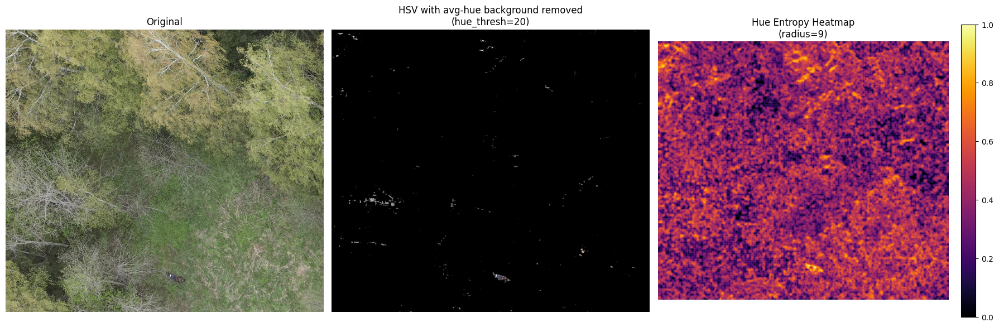

In [98]:
import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk

def visualize_hsv_and_entropy(image_dir, hue_thresh=20, entropy_radius=9):
    """
    Берёт случайное изображение из image_dir, удаляет фон, соответствующий среднему цвету (hue),
    и строит тепловую карту локальной энтропии по каналу hue.
    
    Параметры:
      image_dir       — папка с изображениями;
      hue_thresh      — порог в градусах для удаления пикселей, близких по hue к среднему;
      entropy_radius  — радиус окна (в пикселях) для расчёта локальной энтропии.
    """
    # 1) Выбираем случайное изображение
    imgs = [f for f in os.listdir(image_dir)
            if f.lower().endswith(('.jpg','.jpeg','.png','.tif','.bmp'))]
    img_path = os.path.join(image_dir, random.choice(imgs))
    bgr = cv2.imread(img_path)
    rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)

    # 2) Переводим в HSV и отделяем каналы
    hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    # Hue в OpenCV от 0 до 179. Переведём в int для корректной арифметики
    h = h.astype(np.int16)

    # 3) Вычисляем средний оттенок и формируем маску «фон if |Δh| < hue_thresh»
    h_avg = int(np.round(h.mean()))
    # Учет кольцевой природы hue: приводим разницу в диапазон [-90,90]
    diff = np.abs(((h - h_avg + 90) % 180) - 90)
    mask_bg = diff < hue_thresh

    # 4) Применяем маску: обнуляем фон в HSV
    hsv_masked = hsv.copy()
    hsv_masked[mask_bg] = (0, 0, 0)
    rgb_masked = cv2.cvtColor(hsv_masked, cv2.COLOR_HSV2RGB)

    # 5) Считаем локальную энтропию по каналу hue
    # Для rank.entropy нужен uint8
    h_uint8 = (h % 180).astype(np.uint8)
    ent = entropy(h_uint8, disk(entropy_radius))
    # Нормируем в [0,1]
    ent_norm = ent.astype(np.float32)
    ent_norm /= ent_norm.max()

    # 6) Визуализация
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    ax0, ax1, ax2 = axes

    ax0.imshow(rgb)
    ax0.set_title('Original')
    ax0.axis('off')

    ax1.imshow(rgb_masked)
    ax1.set_title(f'HSV with avg-hue background removed\n(hue_thresh={hue_thresh})')
    ax1.axis('off')

    im = ax2.imshow(ent_norm, cmap='inferno')
    ax2.set_title(f'Hue Entropy Heatmap\n(radius={entropy_radius})')
    ax2.axis('off')
    fig.colorbar(im, ax=ax2, fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()


# Пример использования:
visualize_hsv_and_entropy(r"E:\DroneFootageDataset\dataset\02_part_dataset_human_rescue\02_second_part_DataSet_Human_Rescue\images", hue_thresh=20, entropy_radius=9)



100%|██████████| 34728/34728 [56:27<00:00, 10.25it/s] 


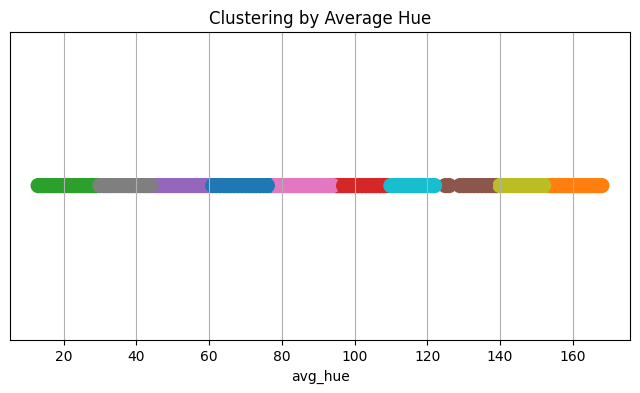

[6 0 3 2 4 7 9 5 8 1]


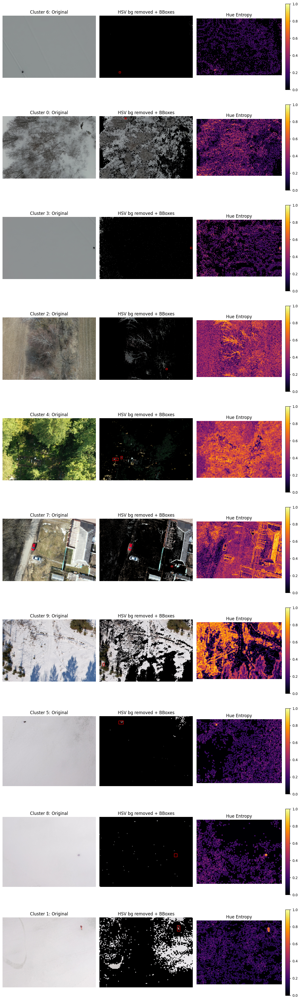

In [101]:
import os
import random
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk
from sklearn.cluster import KMeans

# --- Часть 1: расчет среднего оттенка (hue) для каждого уникального изображения ---
# Предполагаем, что df_final загружен в память и содержит колонку 'image_path'

def compute_avg_hue_for_df(df, hue_radius=0):
    """
    Для каждого уникального image_path вычисляет средний hue (0-179) и добавляет колонку 'avg_hue'.
    Если изображение встречается несколько раз, среднее вычисляется один раз.
    """
    avg_hue_map = {}
    hsv_cache = {}
    pbar=tqdm(df['image_path'].unique())
    for img_path in pbar:
        bgr = cv2.imread(img_path)
        hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
        h = hsv[:, :, 0].astype(np.int32)
        avg = int(np.round(h.mean()))
        avg_hue_map[img_path] = avg

    df['avg_hue'] = df['image_path'].map(avg_hue_map)
    return df

# --- Часть 2: кластеризация по avg_hue и визуализация результатов ---

def cluster_by_hue(df, n_clusters=3):
    """
    Кластеризует изображения по среднему hue и добавляет колонку 'cluster'.
    Строит scatter plot avg_hue vs index (или порядковый номер) цветом по кластеру.
    """
    X = df[['avg_hue']].drop_duplicates().to_numpy()
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(X)

    # Map unique hues to clusters
    unique_hues = df['avg_hue'].unique()
    hue_to_cluster = {h: label for h, label in zip(unique_hues, labels)}
    df['cluster'] = df['avg_hue'].map(hue_to_cluster)

    # Визуализация кластеров
    plt.figure(figsize=(8, 4))
    plt.scatter(unique_hues, [0]*len(unique_hues), c=labels, cmap='tab10', s=100)
    plt.title('Clustering by Average Hue')
    plt.xlabel('avg_hue')
    plt.yticks([])
    plt.grid(True)
    plt.show()

    return df

# --- Часть 3: функция визуализации для каждого кластера ---

def visualize_clusters(df, hue_thresh=20, entropy_radius=9):
    """
    Для каждого кластера берет случайное изображение,
    удаляет фон по avg_hue из df, строит heatmap энтропии и накладывает bounding boxes.
    """
    clusters = df['cluster'].unique()
    fig, axes = plt.subplots(len(clusters), 3, figsize=(12, 4*len(clusters)))
    if len(clusters) == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, cl in enumerate(clusters):
        sub = df[df['cluster'] == cl]
        img_path = random.choice(sub['image_path'].unique())
        lbls = sub[sub['image_path'] == img_path]['label_path'].unique()

        # чтение изображения
        bgr = cv2.imread(img_path)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
        h = hsv[:, :, 0].astype(np.int32)

        # удаление фона по avg_hue
        avg_h = int(df[df['image_path'] == img_path]['avg_hue'].iloc[0])
        diff = np.abs(((h - avg_h + 90) % 180) - 90)
        mask_bg = diff < hue_thresh
        hsv_masked = hsv.copy()
        hsv_masked[mask_bg] = (0, 0, 0)
        rgb_masked = cv2.cvtColor(hsv_masked, cv2.COLOR_HSV2RGB)

        # энтропия по hue
        h_uint8 = (h % 180).astype(np.uint8)
        ent = entropy(h_uint8, disk(entropy_radius))
        ent_norm = ent.astype(np.float32)
        ent_norm /= ent_norm.max()

        ax_orig, ax_proc, ax_ent = axes[i]
        ax_orig.imshow(rgb)
        ax_orig.set_title(f'Cluster {cl}: Original')
        ax_orig.axis('off')

        # Накладываем bbox на processed image
        ax_proc.imshow(rgb_masked)
        for lbl in lbls:
            # читаем аннотации YOLO: class xc yc w h
            with open(lbl, 'r', encoding='utf-8') as f:
                for line in f:
                    parts = line.split()
                    if len(parts) < 5:
                        continue
                    xc, yc, w_norm, h_norm = map(float, parts[1:5])
                    H, W = rgb.shape[:2]
                    # координаты в пикселях
                    x1 = int((xc - w_norm/2)*W)
                    y1 = int((yc - h_norm/2)*H)
                    x2 = int((xc + w_norm/2)*W)
                    y2 = int((yc + h_norm/2)*H)
                    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1,
                                         edgecolor='red', facecolor='none', lw=1)
                    ax_proc.add_patch(rect)
        ax_proc.set_title('HSV bg removed + BBoxes')
        ax_proc.axis('off')

        im = ax_ent.imshow(ent_norm, cmap='inferno')
        ax_ent.set_title('Hue Entropy')
        ax_ent.axis('off')
        fig.colorbar(im, ax=ax_ent, fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()

# --- Пример использования всей цепочки ---
df = compute_avg_hue_for_df(df_final)
df = cluster_by_hue(df, n_clusters=10)
print(df['cluster'].unique())
visualize_clusters(df)


In [2]:
import cv2
import numpy as np
from concurrent.futures import ProcessPoolExecutor, as_completed
from tqdm import tqdm
import pandas as pd
from concurrent.futures import ThreadPoolExecutor, as_completed
# остальной импорт тот же

def avg_hue_for_path(img_path, downscale_factor):
    bgr = cv2.imread(img_path)
    if bgr is None:
        return img_path, None
    if downscale_factor > 1:
        h, w = bgr.shape[:2]
        bgr = cv2.resize(bgr, (w//downscale_factor, h//downscale_factor),
                         interpolation=cv2.INTER_NEAREST)
    hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
    return img_path, int(np.round(hsv[...,0].mean()))

def compute_avg_hue_threads(df, n_workers=12, downscale=4):
    uniq = df['image_path'].unique()
    avg_hue_map = {}
    with ThreadPoolExecutor(max_workers=n_workers) as exe:
        futures = {exe.submit(avg_hue_for_path, p, downscale): p for p in uniq}
        for fut in tqdm(as_completed(futures),
                        total=len(futures),
                        desc='Computing avg_hue'):
            img_path, avg = fut.result()
            avg_hue_map[img_path] = avg
    df['avg_hue'] = df['image_path'].map(avg_hue_map)
    return df

df = pd.read_pickle(r"E:\DroneFootageDataset\cropped.pkl")

# Вызываем просто:
df = compute_avg_hue_threads(df, n_workers=12, downscale=4)


Computing avg_hue: 100%|██████████| 34728/34728 [08:28<00:00, 68.33it/s] 


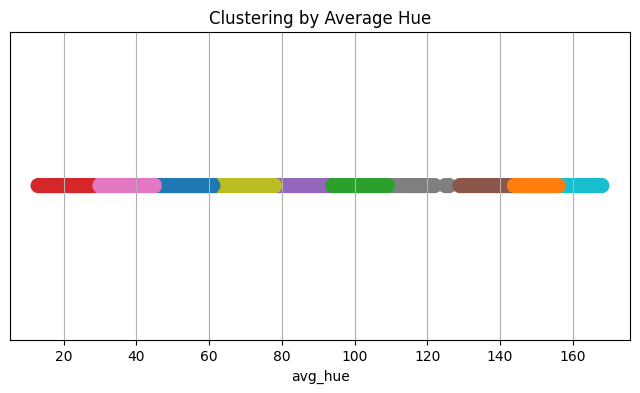

[4 8 2 6 0 3 7 5 9 1]


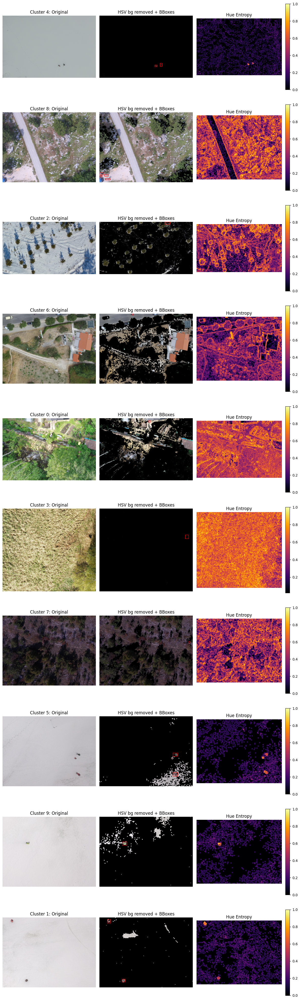

In [ ]:
import os
import random
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk
from sklearn.cluster import KMeans

def visualize_clusters(df, hue_thresh=20, entropy_radius=9):
    """
    Для каждого кластера берет случайное изображение,
    удаляет фон по avg_hue из df, строит heatmap энтропии и накладывает bounding boxes.
    """
    clusters = df['cluster'].unique()
    fig, axes = plt.subplots(len(clusters), 3, figsize=(12, 4*len(clusters)))
    if len(clusters) == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, cl in enumerate(clusters):
        sub = df[df['cluster'] == cl]
        img_path = random.choice(sub['image_path'].unique())
        lbls = sub[sub['image_path'] == img_path]['label_path'].unique()

        # чтение изображения
        bgr = cv2.imread(img_path)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
        h = hsv[:, :, 0].astype(np.int32)

        # удаление фона по avg_hue
        avg_h = int(df[df['image_path'] == img_path]['avg_hue'].iloc[0])
        diff = np.abs(((h - avg_h + 90) % 180) - 90)
        mask_bg = diff < hue_thresh
        hsv_masked = hsv.copy()
        hsv_masked[mask_bg] = (0, 0, 0)
        rgb_masked = cv2.cvtColor(hsv_masked, cv2.COLOR_HSV2RGB)

        # энтропия по hue
        h_uint8 = (h % 180).astype(np.uint8)
        ent = entropy(h_uint8, disk(entropy_radius))
        ent_norm = ent.astype(np.float32)
        ent_norm /= ent_norm.max()

        ax_orig, ax_proc, ax_ent = axes[i]
        ax_orig.imshow(rgb)
        ax_orig.set_title(f'Cluster {cl}: Original')
        ax_orig.axis('off')

        # Накладываем bbox на processed image
        ax_proc.imshow(rgb_masked)
        for lbl in lbls:
            # читаем аннотации YOLO: class xc yc w h
            with open(lbl, 'r', encoding='utf-8') as f:
                for line in f:
                    parts = line.split()
                    if len(parts) < 5:
                        continue
                    xc, yc, w_norm, h_norm = map(float, parts[1:5])
                    H, W = rgb.shape[:2]
                    # координаты в пикселях
                    x1 = int((xc - w_norm/2)*W)
                    y1 = int((yc - h_norm/2)*H)
                    x2 = int((xc + w_norm/2)*W)
                    y2 = int((yc + h_norm/2)*H)
                    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1,
                                         edgecolor='red', facecolor='none', lw=1)
                    ax_proc.add_patch(rect)
        ax_proc.set_title('HSV bg removed + BBoxes')
        ax_proc.axis('off')

        im = ax_ent.imshow(ent_norm, cmap='inferno')
        ax_ent.set_title('Hue Entropy')
        ax_ent.axis('off')
        fig.colorbar(im, ax=ax_ent, fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()

def cluster_by_hue(df, n_clusters=3):
    """
    Кластеризует изображения по среднему hue и добавляет колонку 'cluster'.
    Строит scatter plot avg_hue vs index (или порядковый номер) цветом по кластеру.
    """
    X = df[['avg_hue']].drop_duplicates().to_numpy()
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(X)

    # Map unique hues to clusters
    unique_hues = df['avg_hue'].unique()
    hue_to_cluster = {h: label for h, label in zip(unique_hues, labels)}
    df['cluster'] = df['avg_hue'].map(hue_to_cluster)

    # Визуализация кластеров
    plt.figure(figsize=(8, 4))
    plt.scatter(unique_hues, [0]*len(unique_hues), c=labels, cmap='tab10', s=100)
    plt.title('Clustering by Average Hue')
    plt.xlabel('avg_hue')
    plt.yticks([])
    plt.grid(True)
    plt.show()

    return df


df = cluster_by_hue(df, n_clusters=10)
print(df['cluster'].unique())
visualize_clusters(df)

In [2]:
import numpy as np
from PIL import Image
from concurrent.futures import ThreadPoolExecutor, as_completed
from tqdm import tqdm
import pandas as pd

def normalized_entropy_rgb(path):
    """
    Считает нормализованную энтропию по каналам R, G, B и усредняет их.
    """
    img = Image.open(path).convert('RGB')
    arr = np.array(img)
    H_norms = []
    for c in range(3):
        channel = arr[..., c].ravel()
        hist, _ = np.histogram(channel, bins=256, range=(0,255), density=True)
        probs = hist[hist > 0]
        H = -np.sum(probs * np.log2(probs))
        H_norms.append(H / 8.0)
    return float(np.mean(H_norms))

def compute_entropies_unique(df, max_workers=12):
    """
    1) Берёт только уникальные пути из df['image_path']
    2) Параллельно считает для них энтропию с прогресс-баром
    3) Карта path -> entropy, затем маппит её на весь DataFrame
    """
    # 1. Уникальные пути
    unique_paths = df['image_path'].unique().tolist()
    n = len(unique_paths)
    
    # 2. Параллельный расчёт по уникальным путям
    entropy_map = {}
    with ThreadPoolExecutor(max_workers=max_workers) as executor:
        futures = {
            executor.submit(normalized_entropy_rgb, path): path
            for path in unique_paths
        }
        for future in tqdm(as_completed(futures), total=n, desc="Entropy calc"):
            path = futures[future]
            try:
                entropy_map[path] = future.result()
            except Exception as e:
                entropy_map[path] = np.nan
                print(f"Error processing {path}: {e}")
    
    # 3. Маппинг на весь DataFrame
    df['entropy_rgb'] = df['image_path'].map(entropy_map)
    return df

if __name__ == "__main__":
    df = pd.read_pickle(r'E:\DroneFootageDataset\cropped_with_hues_entropy.pkl')  
    df = compute_entropies_unique(df, max_workers=12)
    df.head()

Entropy calc: 100%|██████████| 34728/34728 [2:50:36<00:00,  3.39it/s]  


In [6]:
df["avg_hue"]=df["avg_hue"]/180
df.head()

,image_path,label_path,targets,height,width,xc,yc,w,h,avg_hue,cluster,entropy,entropy_rgb
0,E:\DroneFootageDataset\dataset\02_part_dataset...,E:\DroneFootageDataset\dataset\02_part_dataset...,4,1824,2736,0.283156,0.964131,0.051529,0.044720,0.488889,4,5.063147,0.789022
1,E:\DroneFootageDataset\dataset\02_part_dataset...,E:\DroneFootageDataset\dataset\02_part_dataset...,4,1824,2736,0.745113,0.752288,0.036071,0.046928,0.488889,4,5.063147,0.789022
2,E:\DroneFootageDataset\dataset\02_part_dataset...,E:\DroneFootageDataset\dataset\02_part_dataset...,4,1824,2736,0.927859,0.364714,0.026869,0.059075,0.488889,4,5.063147,0.789022
3,E:\DroneFootageDataset\dataset\02_part_dataset...,E:\DroneFootageDataset\dataset\02_part_dataset...,4,1824,2736,0.083978,0.972214,0.047334,0.037780,0.488889,4,5.063147,0.789022
4,E:\DroneFootageDataset\dataset\02_part_dataset...,E:\DroneFootageDataset\dataset\02_part_dataset...,2,1824,2736,0.225138,0.797158,0.039428,0.046750,0.416667,8,5.883945,0.912763


In [9]:
import numpy as np

# 1. Преобразуем avg_hue∈[0,1) в угол в радианах
angles = df['avg_hue'].values * 2 * np.pi

# 2. Строим два новых признака — проекции на X и Y
df['hue_x'] = np.cos(angles)
df['hue_y'] = np.sin(angles)


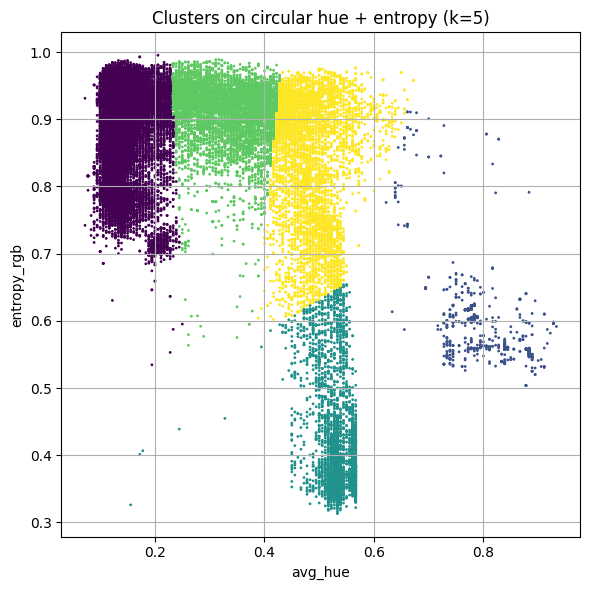

In [40]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# 3. Собираем матрицу признаков
features = df[['hue_x', 'hue_y', 'entropy_rgb']].values

# 4. Нормализация (чтобы entropy и два новых признака были сопоставимы)
features_scaled = StandardScaler().fit_transform(features)

# 5. K-Means
k = 5  # например
labels = KMeans(n_clusters=k, random_state=42).fit_predict(features_scaled)
df['cluster'] = labels

# 6. (Опционально) scatter avg_hue vs entropy_rgb, раскрашенный по кластерам
plt.figure(figsize=(6,6))
plt.scatter(df['avg_hue'], df['entropy_rgb'], c=df['cluster'], s=1)
plt.xlabel('avg_hue')
plt.ylabel('entropy_rgb')
plt.title(f'Clusters on circular hue + entropy (k={k})')
plt.grid(True)
plt.tight_layout()
plt.show()


C:\Users\posei\AppData\Local\Temp\ipykernel_20612\3965984960.py:86: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])


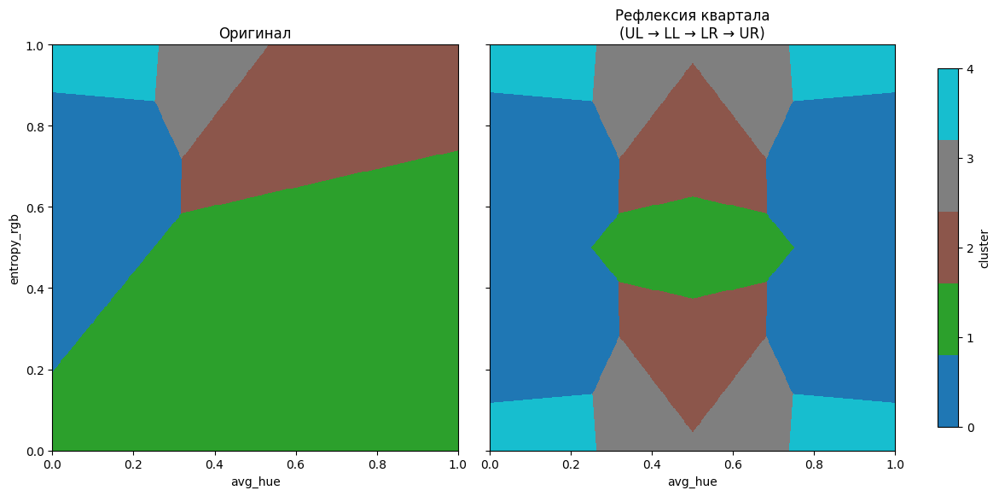

In [41]:
import numpy as np
import matplotlib.pyplot as plt

import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

import numpy as np
import matplotlib.pyplot as plt

def plot_original_and_quadrant_reflection(kmeans, resolution=400, cmap_name='tab10'):
    """
    Два рядом стоящих графика:
    - слева: полное разбиение кластеров на плоскости avg_hue × entropy_rgb;
    - справа: сначала строится только верхний левый квартал, 
      затем этот квартал зеркально отражается по вертикали,
      а получившийся (двухквартальный) блок зеркально отражается по горизонтали,
      в результате заполняя весь квадрат [0,1]×[0,1].
    """
    # 1) Полная сетка и оригинальные метки
    xs = np.linspace(0, 1, resolution)
    ys = np.linspace(0, 1, resolution)
    X, Y = np.meshgrid(xs, ys)
    pts_full = np.column_stack([X.ravel(), Y.ravel()])
    labels_full = kmeans.predict(pts_full).reshape(resolution, resolution)

    # 2) Сетка для верхнего левого квартала
    res2 = resolution // 2
    xs2 = xs[:res2]
    ys2 = ys[res2:]  # верхняя половина
    X2, Y2 = np.meshgrid(xs2, ys2)
    pts_q = np.column_stack([X2.ravel(), Y2.ravel()])
    labels_q = kmeans.predict(pts_q).reshape(res2, res2)

    # 3) Отражения: 
    #    a) вертикальное (зеркало по горизонтальной оси) -> нижний левый
    #    b) оба (сначала вниз, потом вправо) и отдельно горизонтальное
    top_left     = labels_q
    bottom_left  = np.flipud(top_left)
    top_right    = np.fliplr(top_left)
    bottom_right = np.fliplr(bottom_left)

    # 4) Собираем полное отражённое поле
    labels_ref = np.zeros_like(labels_full)
    # Важно: индексы по Y идут вниз, поэтому:
    # строки 0..res2-1 — это низ (entropy small), строки res2..res-1 — это верх
    labels_ref[resolution-res2:resolution,    0:res2] = top_left
    labels_ref[0:resolution-res2,             0:res2] = bottom_left
    labels_ref[resolution-res2:resolution, res2:resolution] = top_right
    labels_ref[0:resolution-res2,          res2:resolution] = bottom_right

    # 5) Рисуем оба
    cmap = plt.get_cmap(cmap_name, kmeans.n_clusters)
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharex=True, sharey=True)

    im1 = ax1.imshow(
        labels_full,
        origin='lower',
        extent=(0,1,0,1),
        cmap=cmap,
        interpolation='nearest',
        aspect='equal'
    )
    ax1.set_title('Оригинал')
    ax1.set_xlabel('avg_hue')
    ax1.set_ylabel('entropy_rgb')

    im2 = ax2.imshow(
        labels_ref,
        origin='lower',
        extent=(0,1,0,1),
        cmap=cmap,
        interpolation='nearest',
        aspect='equal'
    )
    ax2.set_title('Рефлексия квартала\n(UL → LL → LR → UR)')
    ax2.set_xlabel('avg_hue')
    # y-label скрываем, т.к. общий
    ax2.set_ylabel('')

    # общий цветбар
    cax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    plt.colorbar(im2, cax=cax, ticks=range(kmeans.n_clusters))
    cax.set_ylabel('cluster')

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()



# Предположим:
features = df[['avg_hue','entropy_rgb']].values  # оба в [0,1]
kmeans = KMeans(n_clusters=5).fit(features)

plot_original_and_quadrant_reflection(kmeans, resolution=500, cmap_name='tab10')



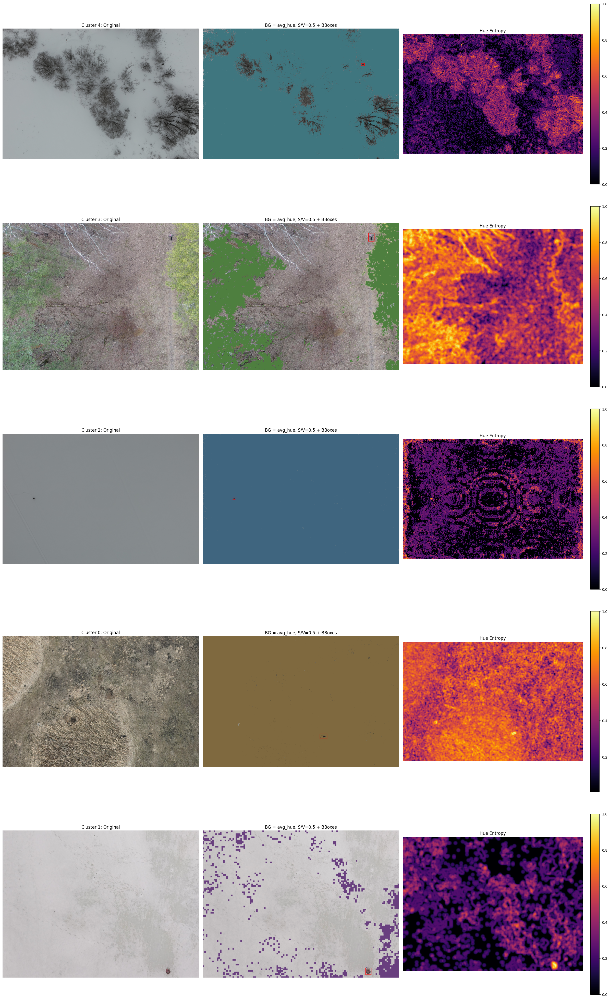

In [46]:
import os
import random
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk
from sklearn.cluster import KMeans

import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk

def visualize_clusters(df, hue_thresh=20, entropy_radius=9):
    clusters = df['cluster'].unique()
    fig, axes = plt.subplots(len(clusters), 3, figsize=(24, 8*len(clusters)))
    if len(clusters) == 1:
        axes = np.expand_dims(axes, axis=0)

    for i, cl in enumerate(clusters):
        sub = df[df['cluster'] == cl]
        img_path = random.choice(sub['image_path'].unique())
        lbls = sub[sub['image_path'] == img_path]['label_path'].unique()

        # Чтение
        bgr = cv2.imread(img_path)
        rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
        hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
        h = hsv[:, :, 0].astype(np.int32)

        # Средний Hue в 0–179
        avg_h = int(sub[sub['image_path'] == img_path]['avg_hue'].iloc[0] * 180)

        # Маска фона по Hue
        diff = np.abs(((h - avg_h + 90) % 180) - 90)
        mask_bg = diff < hue_thresh

        # Копируем и заливаем фон:
        hsv_masked = hsv.copy()
        # 1) Hue
        hsv_masked[:, :, 0][mask_bg] = avg_h
        # 2) Saturation = 0.5 → 127
        hsv_masked[:, :, 1][mask_bg] = 127
        # 3) Value       = 0.5 → 127
        hsv_masked[:, :, 2][mask_bg] = 127

        rgb_masked = cv2.cvtColor(hsv_masked, cv2.COLOR_HSV2RGB)

        # Энтропия по hue
        h_uint8 = (h % 180).astype(np.uint8)
        ent = entropy(h_uint8, disk(entropy_radius))
        ent_norm = ent.astype(np.float32)
        if ent_norm.max() > 0:
            ent_norm /= ent_norm.max()

        ax_orig, ax_proc, ax_ent = axes[i]
        ax_orig.imshow(rgb)
        ax_orig.set_title(f'Cluster {cl}: Original')
        ax_orig.axis('off')

        ax_proc.imshow(rgb_masked)
        H_img, W_img = rgb.shape[:2]
        for lbl in lbls:
            with open(lbl, 'r', encoding='utf-8') as f:
                for line in f:
                    parts = line.split()
                    if len(parts) < 5:
                        continue
                    _, xc, yc, w_norm, h_norm = parts
                    xc, yc, w_norm, h_norm = map(float, (xc, yc, w_norm, h_norm))
                    x1 = int((xc - w_norm/2) * W_img)
                    y1 = int((yc - h_norm/2) * H_img)
                    x2 = int((xc + w_norm/2) * W_img)
                    y2 = int((yc + h_norm/2) * H_img)
                    rect = plt.Rectangle((x1, y1), x2-x1, y2-y1,
                                         edgecolor='red', facecolor='none', lw=1)
                    ax_proc.add_patch(rect)
        ax_proc.set_title('BG = avg_hue, S/V=0.5 + BBoxes')
        ax_proc.axis('off')

        im = ax_ent.imshow(ent_norm, cmap='inferno')
        ax_ent.set_title('Hue Entropy')
        ax_ent.axis('off')
        fig.colorbar(im, ax=ax_ent, fraction=0.046, pad=0.04)

    plt.tight_layout()
    plt.show()


visualize_clusters(df, hue_thresh=20, entropy_radius=20)


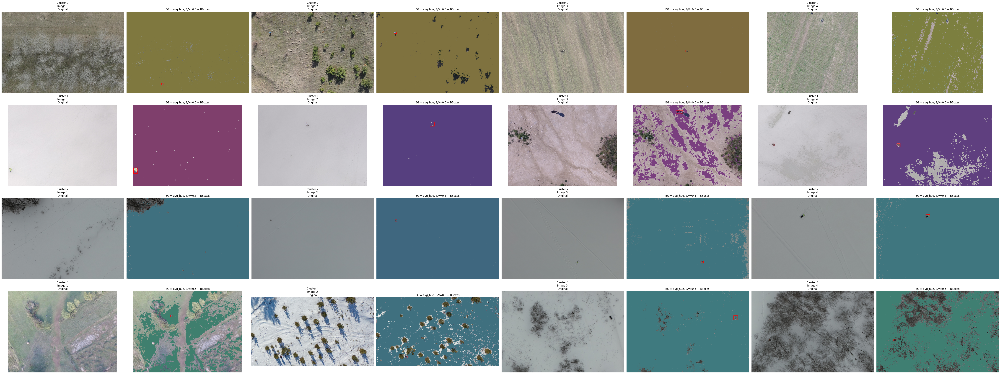

In [51]:
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.filters.rank import entropy
from skimage.morphology import disk

def visualize_clusters_samples(df, clusters_list, n, hue_thresh=20, entropy_radius=50, seed=42):
    """
    Для каждого кластера из списка clusters_list берёт n случайных изображений
    (с контролем случайности через seed), заливает фон по avg_hue из df
    (H = avg_hue, S = 0.5, V = 0.5), строит heatmap энтропии по Hue
    и накладывает bounding boxes из label_path.
    
    Параметры:
    - df: DataFrame с колонками
        'image_path' (путь к картинке),
        'label_path' (путь к YOLO-аннотации),
        'avg_hue' (в [0,1]),
        'cluster' (номера кластеров).
    - clusters_list: список кластеров, которые нужно визуализировать.
    - n: число случайных изображений на кластер.
    - hue_thresh: порог в градусах Hue для маски фона.
    - entropy_radius: радиус структурного элемента для rank-entropy.
    - seed: начальное значение для random.
    """
    random.seed(seed)
    rows = len(clusters_list)
    cols = 2 * n
    fig, axes = plt.subplots(rows, cols,
                             figsize=(8 * cols, 6 * rows),
                             squeeze=False)
    
    for i, cl in enumerate(clusters_list):
        sub_df = df[df['cluster'] == cl]
        unique_imgs = sub_df['image_path'].unique().tolist()
        sample_paths = random.sample(unique_imgs, k=min(n, len(unique_imgs)))
        
        for j, img_path in enumerate(sample_paths):
            # --- чтение и HSV-преобразование ---
            bgr = cv2.imread(img_path)
            rgb = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
            hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
            h = hsv[:, :, 0].astype(np.int32)  # 0…179
            
            # --- средний Hue и маска фона ---
            avg_h = int(sub_df[sub_df['image_path'] == img_path]
                        ['avg_hue'].iloc[0] * 180)
            diff = np.abs(((h - avg_h + 90) % 180) - 90)
            mask_bg = diff < hue_thresh
            
            # --- заполняем фон: H=avg_h, S=127, V=127 ---
            hsv_masked = hsv.copy()
            hsv_masked[:, :, 0][mask_bg] = avg_h       # Hue
            hsv_masked[:, :, 1][mask_bg] = 127         # Saturation
            hsv_masked[:, :, 2][mask_bg] = 127         # Value
            rgb_masked = cv2.cvtColor(hsv_masked, cv2.COLOR_HSV2RGB)
            
            
            # --- bounding boxes ---
            lbls = sub_df[sub_df['image_path'] == img_path]['label_path'].unique()
            
            ax_o = axes[i, j*2 + 0]
            ax_p = axes[i, j*2 + 1]
            
            # 1) оригинал
            ax_o.imshow(rgb)
            ax_o.set_title(f'Cluster {cl}\nImage {j+1}\nOriginal')
            ax_o.axis('off')
            
            # 2) фон залит + BBoxes
            ax_p.imshow(rgb_masked)
            H_img, W_img = rgb.shape[:2]
            for lbl in lbls:
                with open(lbl, 'r') as f:
                    for line in f:
                        parts = line.split()
                        if len(parts) < 5:
                            continue
                        _, xc, yc, w_norm, h_norm = parts
                        xc, yc, w_norm, h_norm = map(float, (xc, yc, w_norm, h_norm))
                        x1 = int((xc - w_norm/2) * W_img)
                        y1 = int((yc - h_norm/2) * H_img)
                        x2 = int((xc + w_norm/2) * W_img)
                        y2 = int((yc + h_norm/2) * H_img)
                        rect = plt.Rectangle((x1, y1),
                                             x2 - x1, y2 - y1,
                                             edgecolor='red',
                                             facecolor='none',
                                             lw=1)
                        ax_p.add_patch(rect)
            ax_p.set_title('BG = avg_hue, S/V=0.5 + BBoxes')
            ax_p.axis('off')
            

    plt.tight_layout()
    plt.show()

# Например, хотим по кластерам 0, 2, 5 вывести по 4 случайных картинки:
visualize_clusters_samples(df, clusters_list=[0,1,2,4], n=4, seed=123)


In [3]:
import numpy as np
from itertools import islice
from tqdm import tqdm
import cv2
from ultralytics import YOLO
import pandas as pd

def chunked(iterable, size):
    """Yield successive size‑length chunks from iterable."""
    it = iter(iterable)
    while True:
        chunk = list(islice(it, size))
        if not chunk:
            return
        yield chunk

def gather_preds_by_resolution(df: pd.DataFrame,
                               model: YOLO,
                               batch_size: int = 16,
                               conf: float = 0.25):
    """
    Группирует уникальные пути по (height,width) из df,
    для каждой группы бьёт список путей на чанки по batch_size
    и собирает предсказания model.predict(...) с прогрессбаром.
    
    Возвращает dict: { image_path: [ [x1,y1,x2,y2], ... ] }
    """
    pred_dict = {}
    grouped = df.groupby(['height','width'])['image_path'].unique()
    
    for (H, W), paths in grouped.items():
        desc = f"{H}×{W} → {len(paths)} imgs"
        batch_size = max(1, (12 * 1024**3) // (H * W * 3 * 4))
        for chunk in tqdm(chunked(paths, batch_size),
                          desc=desc, leave=False):
            # используем batch=len(chunk) чтобы YOLO брал весь чанк
            results = model.predict(
                source=list(chunk),
                conf=conf,
                batch=len(chunk),
                verbose=False,
                show=False,
                save=False
            )
            for res in results:
                # списки [x1,y1,x2,y3]
                pred_dict[res.path] = res.boxes.xyxy.cpu().numpy().tolist()
    return pred_dict

def compute_Q_from_preds(df: pd.DataFrame,
                         pred_dict: dict,
                         iou_thresholds=np.arange(0.3, 0.94, 0.07),
                         beta: float = 1.0):
    """
    По готовому pred_dict и аннотациям в df считает метрику Q.
    Показывает прогресс по изображениям.
    """
    beta2 = beta**2
    thresh = list(iou_thresholds)
    N = len(thresh)
    TP = np.zeros(N, dtype=int)
    FN = np.zeros(N, dtype=int)
    FP = np.zeros(N, dtype=int)
    
    for _, row in tqdm(df.iterrows(), total=len(df), desc="Computing Q"):
        img = row['image_path']
        H, W = row['height'], row['width']
        
        # ground-truth boxes
        gt = []
        with open(row['label_path'], 'r') as f:
            for ln in f:
                parts = ln.split()
                if len(parts) < 5:
                    continue
                _, xc, yc, w, h = parts
                xc, yc, w, h = map(float, (xc, yc, w, h))
                x1 = (xc - w/2)*W
                y1 = (yc - h/2)*H
                x2 = (xc + w/2)*W
                y2 = (yc + h/2)*H
                gt.append([x1, y1, x2, y2])
        
        preds = pred_dict.get(img, [])
        # IoU matrix
        M = np.zeros((len(preds), len(gt)), dtype=float)
        for i, pb in enumerate(preds):
            for j, gb in enumerate(gt):
                xa, ya = max(pb[0], gb[0]), max(pb[1], gb[1])
                xb, yb = min(pb[2], gb[2]), min(pb[3], gb[3])
                inter = max(0, xb-xa)*max(0, yb-ya)
                area_p = max(0, pb[2]-pb[0])*max(0, pb[3]-pb[1])
                area_g = max(0, gb[2]-gb[0])*max(0, gb[3]-gb[1])
                uni = area_p + area_g - inter
                M[i, j] = inter/uni if uni>0 else 0.0
        
        for k, t in enumerate(thresh):
            Mc = M.copy()
            tp = 0
            while Mc.size:
                i, j = np.unravel_index(Mc.argmax(), Mc.shape)
                if Mc[i, j] >= t:
                    tp += 1
                    Mc = np.delete(Mc, i, axis=0)
                    Mc = np.delete(Mc, j, axis=1)
                else:
                    break
            fn = Mc.shape[1]
            fp = Mc.shape[0]
            TP[k] += tp
            FN[k] += fn
            FP[k] += fp
    
    F = (1 + beta2)*TP / ((1 + beta2)*TP + beta2*FN + FP + 1e-16)
    Q = F.mean()
    return Q, dict(zip(thresh, F))
# --- Пример использования ---
df=pd.read_pickle(r"E:\DroneFootageDataset\last_used.pkl")
model = YOLO('yolo11s.pt')
pred_dict = gather_preds_by_resolution(df, model, batch_size=200, conf=0.25)
Q, F_per_t = compute_Q_from_preds(df, pred_dict)
print("Q =", Q)
for t, f in F_per_t.items():
    print(f"IoU≥{t:.2f}: F₁={f:.3f}")



KeyboardInterrupt: 

In [ ]:
import os
import cv2
import torch
import numpy as np
from tqdm import tqdm
from ultralytics import YOLO
from torch.utils.data import Dataset, DataLoader
import multiprocessing
import pandas as pd

# 1) Установим стартовый метод (только нужно сделать это до любых DataLoader'ов)
multiprocessing.set_start_method("spawn", force=True)

class ResDataset(Dataset):
    """Датасет, читающий RGB→float32 тензор C×H×W и возвращающий путь."""
    def __init__(self, paths):
        self.paths = paths

    def __len__(self):
        return len(self.paths)

    def __getitem__(self, idx):
        path = self.paths[idx]
        try:
            img = cv2.imread(path)
            img = img[:, :, ::-1]  # BGR→RGB
            tensor = torch.from_numpy(img.astype(np.float32) / 255.0).permute(2, 0, 1)
            return tensor, path
        except Exception as e:
            # вместо падения вернём нулевой тензор, который YOLO просто не детектит
            print(f"[Dataset] failed to load {path}: {e}")
            dummy = torch.zeros(3, 1, 1, dtype=torch.float32)
            return dummy, path

def gather_preds_by_resolution(df, model: YOLO,
                               batch_size=16,
                               num_workers=4,
                               conf=0.25,
                               device=None):
    device = device or (torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu"))
    model.model.to(device).eval()
    pred_dict = {}
    grouped = df.groupby(['height', 'width'])['image_path'].unique()

    for (H, W), paths in grouped.items():
        desc = f"{H}×{W} → {len(paths)} imgs"
        ds = ResDataset(list(paths))
        loader = DataLoader(
            ds,
            batch_size=batch_size,
            shuffle=False,
            num_workers=num_workers,
            pin_memory=True,
            drop_last=False
        )
        for batch_imgs, batch_paths in tqdm(loader, desc=desc, leave=False):
            batch_imgs = batch_imgs.to(device, non_blocking=True)
            with torch.no_grad():
                out = model.model(batch_imgs)
                preds = model.model.postprocess(out, batch_imgs, imgsz=(H, W))
            for res, p in zip(preds, batch_paths):
                mask = res.boxes.conf.cpu() > conf
                boxes = res.boxes.xyxy.cpu().numpy()[mask.cpu().numpy()].tolist()
                pred_dict[p] = boxes

    return pred_dict

def main():
    df=pd.read_pickle(r"E:\DroneFootageDataset\last_used.pkl")
    model = YOLO('yolov8n.pt')
    pred_dict = gather_preds_by_resolution(
        df,
        model,
        batch_size=10,        # подберите по нагрузке GPU
        num_workers=12,       # число процессов загрузки
        conf=0.25
    )
    print("Done. Collected preds for", len(pred_dict), "images.")

if __name__ == "__main__":
    main()



RuntimeError: DataLoader worker (pid(s) 22088, 24524, 24924, 14708, 15324, 21424, 24944, 6052, 14608, 2744, 3100, 24864) exited unexpectedly

: 